<a href="https://colab.research.google.com/github/samcode22/Code-Compiler/blob/master/Omdena_analysis_samyak-Mehta.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
import pandas.util.testing as tm

In [4]:
from google.colab import files
uploaded = files.upload()

Saving allData1.csv to allData1.csv


In [5]:
df =  pd.read_csv('allData1.csv',error_bad_lines=False)

In [6]:
df.head()

,Column,id,latitude,longitude,continent,country,aa1,aa2,locality,subLocality,types,updateTime,updateNeeded,note,status,size,anonymous,created,accessibility
0,0,57823,32.354964,35.019643,Asia,Israel,Center District,HaSharon,Bahan,Bahan,domestic,2020-06-22T07:10:14.884Z,False,NaN,cleaned,bag,False,2020-06-22T06:25:01.411Z,NaN
1,1,57814,34.929792,32.862968,Asia,Cyprus,Limassol,NaN,NaN,Limassol,"deadAnimals,plastic",2020-06-21T11:17:53.751Z,False,NaN,stillHere,bag,False,2020-06-21T11:17:53.751Z,notForGeneralCleanup
2,2,57758,40.235476,44.505753,Asia,Armenia,Kotayk Province,NaN,Zovuni,Zovuni,metal,2020-06-15T10:08:23.046Z,False,NaN,stillHere,wheelbarrow,False,2020-06-15T10:08:23.046Z,NaN
3,3,57594,-6.119567,106.661225,Asia,Indonesia,Banten,Kota Tangerang,NaN,RW 010,"electronic,domestic,glass,metal,plastic",2020-06-04T12:22:35.542Z,False,NaN,stillHere,car,False,2020-06-04T12:22:35.542Z,byCar
4,4,57585,-2.677623,118.889706,Asia,Indonesia,Sulawesi Barat,Kabupaten Mamuju,NaN,Binanga,"glass,metal,plastic,domestic",2020-06-02T22:06:37.892Z,False,NaN,stillHere,car,False,2020-06-02T22:06:37.892Z,byCar


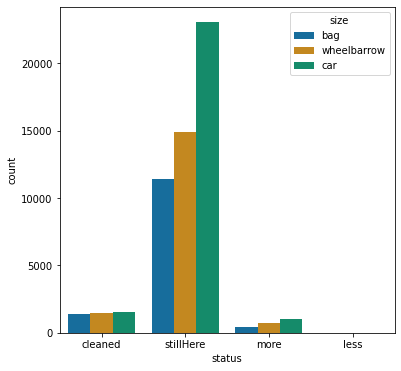

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.subplots(figsize =(6,6))
sns.countplot(x = 'status' , hue ='size', data = df , palette ='colorblind')

In [64]:
dataframe = pd.DataFrame(df, columns = ['latitude' , 'longitude','continent', 'country', 'types', 'status', 'size']) 
asia = dataframe[dataframe['continent'] == 'Asia' ]
euro = dataframe[dataframe['continent'] == 'Europe']
status = dataframe[(dataframe['continent'] == 'Asia') & (dataframe['status'] == 'stillHere')]
status.head(10)

,latitude,longitude,continent,country,types,status,size
1,34.929792,32.862968,Asia,Cyprus,"deadAnimals,plastic",stillHere,bag
2,40.235476,44.505753,Asia,Armenia,metal,stillHere,wheelbarrow
3,-6.119567,106.661225,Asia,Indonesia,"electronic,domestic,glass,metal,plastic",stillHere,car
4,-2.677623,118.889706,Asia,Indonesia,"glass,metal,plastic,domestic",stillHere,car
5,-2.674721,118.887050,Asia,Indonesia,"liquid,metal,plastic,domestic",stillHere,car
7,-2.675818,118.888209,Asia,Indonesia,"glass,organic,metal,domestic,plastic",stillHere,car
8,-2.675086,118.862406,Asia,Indonesia,"glass,organic,metal,plastic,domestic",stillHere,car
9,-2.673063,118.860622,Asia,Indonesia,"glass,metal,plastic,domestic",stillHere,car
10,15.466567,73.849480,Asia,India,domestic,stillHere,bag
11,32.750642,34.974337,Asia,Israel,plastic,stillHere,bag


In [9]:
import folium
plastic_count = 0
others_count = 0
a = ['plastic']
m = folium.Map(location = [asia['latitude'][0] ,asia['longitude'][0]], zoom_start =3)
for i in range(0,asia.shape[0]):
  if any(x in asia['types'][i] for x in a):
    folium.Marker(location = [asia['latitude'][i] , asia['longitude'][i]],icon=folium.Icon(color='red', icon='info-sign')).add_to(m)
    plastic_count += 1
  else:
    others_count += 1
    folium.Marker(location = [asia['latitude'][i] , asia['longitude'][i]]).add_to(m)

    
m

In [11]:
import folium
from folium.plugins import MarkerCluster

a = ['plastic']
n = folium.Map(location = [euro['latitude'][7205] ,euro['longitude'][7205]], zoom_start =3)
for i in range(7205,euro.shape[0]):
  if any(x in euro['types'][i] for x in a):
    folium.Circle(
      location=[euro.iloc[i]['longitude'], euro.iloc[i]['latitude']],
      radius= 3,
      color='crimson',
      fill=True,
      fill_color='crimson'
   ).add_to(n)
    plastic_count += 1
  else:
    others_count += 1
    folium.Circle(
      location=[euro.iloc[i]['longitude'], euro.iloc[i]['latitude']],
      radius= 3,
      color='green',
      fill=True,
      fill_color='green'
   ).add_to(n)
    plastic_count += 1
n

In [144]:
x = (plastic_count/(plastic_count+others_count))*100
y = 100 - x
print(x)
#This much percentage has plastic involvement in asia and europe out of all wastes.

68.53622063639288


In [ ]:
import folium
m = folium.Map(location = [df['latitude'][0] ,df['longitude'][0]], zoom_start =3)
for i in range(0,56039):
  if df['continent'][i] == 'Asia' :
    folium.Marker(location = [df['latitude'][i] , df['longitude'][i]]).add_to(m)
m

In [88]:
x =[]
for i in range(0,43):
  x.append(status['country'].value_counts().sort_index()[i])
print(len(x))
print(x)

43
[30, 10, 9, 1, 13, 5, 26, 21, 4, 83, 243, 1, 11, 27, 15, 84, 176, 8, 2, 2, 38, 21, 1, 6, 1, 46, 26, 162, 1, 2, 1, 7, 7, 5, 16, 3, 21, 264, 1, 2, 4, 24, 16]


In [87]:
asia.sort_values(['country']).country.unique()
arr = np.array(asia.sort_values(['country']).country.unique())
list1 = arr.tolist()
print(len(list1))
print(list1)


  

43
['Armenia', 'Azerbaijan', 'Bangladesh', 'Bhutan', 'Cambodia', 'China', 'Cyprus', 'Georgia', 'Hong Kong', 'India', 'Indonesia', 'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Lebanon', 'Malaysia', 'Maldives', 'Mongolia', 'Myanmar (Burma)', 'Nepal', 'Pakistan', 'Philippines', 'Qatar', 'Russian Federation', 'Saudi Arabia', 'Singapore', 'South Korea', 'Sri Lanka', 'Taiwan', 'Tajikistan', 'Thailand', 'Turkey', 'Turkmenistan', 'United Arab Emirates', 'Uzbekistan', 'Vietnam', 'Yemen']


In [15]:
pip install pycountry

     |████████████████████████████████| 10.0MB 4.8MB/s 
  Created wheel for pycountry: filename=pycountry-19.8.18-py2.py3-none-any.whl size=10627361 sha256=1fc20f63e169587c6fa454393c30d0f4b86d2331958058a25793dcb71385330f
  Stored in directory: /root/.cache/pip/wheels/a2/98/bf/f0fa1c6bf8cf2cbdb750d583f84be51c2cd8272460b8b36bd3
Successfully built pycountry


In [90]:
import pycountry

input_countries = list1

countries = {}
for country in pycountry.countries:
    countries[country.name] = country.alpha_2

codes = [countries.get(country, 'Unknown code') for country in input_countries]

print(codes)  # prints ['AS', 'CA', 'FR']

['AM', 'AZ', 'BD', 'BT', 'KH', 'CN', 'CY', 'GE', 'HK', 'IN', 'ID', 'Unknown code', 'IQ', 'IL', 'JP', 'JO', 'KZ', 'KW', 'KG', 'Unknown code', 'LB', 'MY', 'MV', 'MN', 'Unknown code', 'NP', 'PK', 'PH', 'QA', 'RU', 'SA', 'SG', 'Unknown code', 'LK', 'Unknown code', 'TJ', 'TH', 'TR', 'TM', 'AE', 'UZ', 'Unknown code', 'YE']


In [93]:
d = {'count': [30, 10, 9, 1, 13, 5, 26, 21, 4, 83, 243, 1, 11, 27, 15, 84, 176, 8, 2, 2, 38, 21, 1, 6, 1, 46, 26, 162, 1, 2, 1, 7, 7, 5, 16, 3, 21, 264, 1, 2, 4, 24, 16], 'country' :['Armenia', 'Azerbaijan', 'Bangladesh', 'Bhutan', 'Cambodia', 'China', 'Cyprus', 'Georgia', 'Hong Kong', 'India', 'Indonesia', 'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Lebanon', 'Malaysia', 'Maldives', 'Mongolia', 'Myanmar (Burma)', 'Nepal', 'Pakistan', 'Philippines', 'Qatar', 'Russian Federation', 'Saudi Arabia', 'Singapore', 'South Korea', 'Sri Lanka', 'Taiwan', 'Tajikistan', 'Thailand', 'Turkey', 'Turkmenistan', 'United Arab Emirates', 'Uzbekistan', 'Vietnam', 'Yemen'] , 'codes':['AM', 'AZ', 'BD', 'BT', 'KH', 'CN', 'CY', 'GE', 'HK', 'IN', 'ID', 'Unknown code', 'IQ', 'IL', 'JP', 'JO', 'KZ', 'KW', 'KG', 'Unknown code', 'LB', 'MY', 'MV', 'MN', 'Unknown code', 'NP', 'PK', 'PH', 'QA', 'RU', 'SA', 'SG', 'Unknown code', 'LK', 'Unknown code', 'TJ', 'TH', 'TR', 'TM', 'AE', 'UZ', 'Unknown code', 'YE']}
chloro = pd.DataFrame(d)
chloro.head()

,count,country,codes
0,30,Armenia,AM
1,10,Azerbaijan,AZ
2,9,Bangladesh,BD
3,1,Bhutan,BT
4,13,Cambodia,KH


In [115]:
pip install geopandas

     |████████████████████████████████| 962kB 4.7MB/s 
     |████████████████████████████████| 10.9MB 25.0MB/s 
     |████████████████████████████████| 14.7MB 28.2MB/s 


In [128]:
import plotly.graph_objects as go
fig = go.Figure( go.Scatter(x=chloro['country'], y=chloro['count'] ) )
fig.show()


In [143]:
import plotly.offline as plt
data=[dict(type='choropleth', autocolorscale = False,
locations = chloro['country'], z = chloro['count'], locationmode = 'country names', colorscale= 'sunsetdark', colorbar=dict(title='thousand dollar'))]
layout = dict(title='Country wise stillHere data in asia',geo=dict(scope='asia', projection=dict(type='natural earth'), showlakes=True, lakecolor='rgb(66,165,245)'))
fig=dict(data=data, layout=layout)
plt.plot(fig)

'temp-plot.html'